<a href="https://colab.research.google.com/github/PhoebeDuncombe/abstractbook/blob/master/Copy_of_LOOP_SPINE_SAM_segment_BOX_V4_bone.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/how-to-segment-anything-with-sam.ipynb?ref=blog.roboflow.com#scrollTo=dgS8jFPMnj5h

#navigate to Edit -> Notebook settings -> Hardware accelerator, set it to GPU, and then click Save.
!nvidia-smi

Fri Oct 25 05:08:34 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   52C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
!pip install -q jupyter_bbox_widget roboflow dataclasses-json supervision
!pip install pydicom

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.3/80.3 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.2/158.2 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 213.7/213.7 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.5/49.5 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 727.4/727.4 kB 22.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 15.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 28.1 MB/s eta 0:00:00


In [3]:
import os
HOME = os.getcwd()
print("HOME:", HOME)
%cd {HOME}

import sys
!{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

%cd {HOME}
!mkdir {HOME}/weights
%cd {HOME}/weights

!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth



HOME: /content
/content
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-77asu7v7
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-77asu7v7
  Resolved https://github.com/facebookresearch/segment-anything.git to commit dca509fe793f601edb92606367a655c15ac00fdf
  Preparing metadata (setup.py) ... done
  Created wheel for segment_anything: filename=segment_anything-1.0-py3-none-any.whl size=36592 sha256=8938260961f9eb5948021f9b44b4b8232f473e34820a1336ac906334cf27c522
  Stored in directory: /tmp/pip-ephem-wheel-cache-csr9slue/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment_anything
/content
/content/weights


In [22]:
import os
#HOME = os.getcwd() UNCOMMENT THIS WHEN RUNNING for second time

CHECKPOINT_PATH = os.path.join(HOME, "weights", "sam_vit_h_4b8939.pth")
print(CHECKPOINT_PATH, "; exist:", os.path.isfile(CHECKPOINT_PATH))

# %cd {HOME}
# !mkdir {HOME}/data
# %cd {HOME}/data

import torch

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"

from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)
#mask_generator = SamAutomaticMaskGenerator(sam)
mask_predictor = SamPredictor(sam)

/content/weights/sam_vit_h_4b8939.pth ; exist: True


ModuleNotFoundError: No module named 'sam2'

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact, fixed

# Global variables to store the values
windowed_image_result = None
low_value_result = 0
high_value_result = 255

def adjust_window(image, width, level): ############################################################
    global windowed_image_result, low_value_result, high_value_result

    # Compute windowing parameters
    low_value = level - width / 2
    high_value = level + width / 2

    # Clip pixel values to be in the valid range [0, 255]
    windowed_image = np.clip(image, low_value, high_value)

    # Convert to uint8 for display
    windowed_image = ((windowed_image - low_value) / (high_value - low_value) * 255).astype(np.uint8)

    # Update global variables
    windowed_image_result = windowed_image
    low_value_result = low_value
    high_value_result = high_value

    # Plot the original and adjusted images
    fig, ax = plt.subplots(dpi=150, ncols=2, nrows=1, figsize=(6, 4))

    ax[0].set_title('Original Image')
    ax[0].imshow(image, cmap='gray')
    ax[0].axis('off')

    ax[1].set_title(f'Window Level: {level}, Window Width: {width}')
    ax[1].imshow(windowed_image, cmap='gray')
    ax[1].axis('off')

    plt.show()

    return windowed_image, low_value, high_value

# Example usage with interact:
# Assuming 'image' is your input image array

# helper function that loads an image before adding it to the widget
import base64
import cv2  # Assuming you have OpenCV installed

def encode_image(ctm):
    # Convert the grayscale image to a JPG format
    #im = cv2.cvtColor(im, cv2.COLOR_GRAY2BGR)

    # Encode the image as JPEG
    _, encoded = cv2.imencode('.jpg', ctm)

    # Convert the encoded image to Base64
    encoded_base64 = base64.b64encode(encoded).decode('utf-8')

    return "data:image/jpg;base64," + encoded_base64

In [15]:
from google.colab import drive
drive.mount('/content/drive/')


Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


00000018.dcm
00000037.dcm
00000006.dcm
00000007.dcm
00000040.dcm
00000043.dcm
00000020.dcm
00000010.dcm
00000029.dcm
00000033.dcm
00000035.dcm
00000009.dcm
00000032.dcm
00000004.dcm
00000013.dcm
00000049.dcm
00000048.dcm
00000024.dcm
00000019.dcm
00000008.dcm
00000038.dcm
00000027.dcm
00000011.dcm
00000039.dcm
00000042.dcm
00000017.dcm
00000023.dcm
00000005.dcm
00000031.dcm
00000047.dcm
00000025.dcm
00000015.dcm
00000021.dcm
00000026.dcm
00000044.dcm
00000050.dcm
00000036.dcm
00000046.dcm
00000030.dcm
00000028.dcm
00000045.dcm
00000014.dcm
00000041.dcm
00000022.dcm
00000012.dcm
00000034.dcm
00000016.dcm


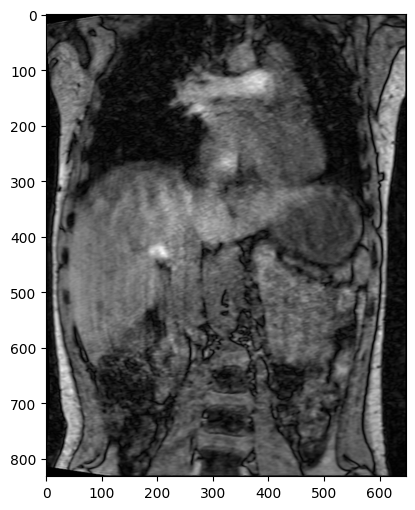

In [16]:
import glob
import os
import numpy as np
import matplotlib.pyplot as plt
from pydicom import dcmread


folder_path = '/content/drive/My Drive/Segment'
#tif_files = glob.glob(folder_path + '/*.npy')
tif_files = glob.glob(folder_path + '/*.dcm')


# Check if any files were found
if tif_files:
    for file_path in tif_files:
        file_name = os.path.basename(file_path)
        print(file_name)

    # Access the last file path from the loop
    # (or modify to select a specific file if needed)


    # ... (rest of your code) ...
else:
    print(f"No .dcm files found in {folder_path}")

ds = dcmread(file_path)
im = ds.pixel_array

#dataLoaded = np.load(file_path, allow_pickle=True)
#im = dataLoaded[10]

#im = (rgb2gray(im)*255).astype('uint8') #SAVE
plt.subplots(figsize = (6,6), dpi=100)
plt.imshow(im, cmap='gray')

#im = Image.open(file_name)#to use later when saving the files
#im.show()
file_name_save = file_name[:-10]

In [17]:
from ipywidgets import interact, fixed

windowed_image = interact(adjust_window, image=fixed(im), width=(1, 589, 1), level=(0, 223, 1))


interactive(children=(IntSlider(value=295, description='width', max=589, min=1), IntSlider(value=111, descript…

In [18]:
IS_COLAB = True

if IS_COLAB:
    from google.colab import output
    output.enable_custom_widget_manager()

from jupyter_bbox_widget import BBoxWidget

widget = BBoxWidget()
widget.image = encode_image(im)
widget

BBoxWidget(colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#b…

In [19]:
import numpy as np

#SamPredictor.predict method takes np.ndarray box argument in [x_min, y_min, x_max, y_max] format. Let's reorganise your data first

# default_box is going to be used if you will not draw any box on image above
default_box = {'x': 68, 'y': 247, 'width': 555, 'height': 678, 'label': ''}

box = widget.bboxes[0] if widget.bboxes else default_box
box = np.array([
    box['x'],
    box['y'],
    box['x'] + box['width'],
    box['y'] + box['height']
])

In [20]:
import cv2
import numpy as np
import supervision as sv

# Define a class to hold the segmentation results
class SegmentationResult:
    def __init__(self, file_name, image_rgb, im, masks, scores, logits):
        self.file_name = file_name
        self.image_rgb = image_rgb
        self.im = im
        self.masks = masks
        self.scores = scores
        self.logits = logits

# List to store the segmentation results
segmentation_results = []

# Iterate over each file path
for file_path in tif_files:

    file_name = os.path.splitext(os.path.basename(file_path))[0]  # to create name later, without the extension
    ds = dcmread(file_path)
    im = ds.pixel_array

    epsilon = 1e-8  # A small value to avoid division by zero
    modified_im = np.clip(im, low_value_result, high_value_result)
    modified_im = ((modified_im - low_value_result) / (high_value_result - low_value_result + epsilon) * 255).astype(np.uint8)
    image_rgb = cv2.cvtColor(modified_im, cv2.COLOR_BGR2RGB) ############################3

    # Set the image for the mask predictor
    mask_predictor.set_image(image_rgb)

    # Perform segmentation
    masks, scores, logits = mask_predictor.predict(
        box=box,
        multimask_output=True
    )

    # Create a SegmentationResult object and add it to the list
    result = SegmentationResult(file_name, image_rgb, im, masks, scores, logits)
    segmentation_results.append(result)

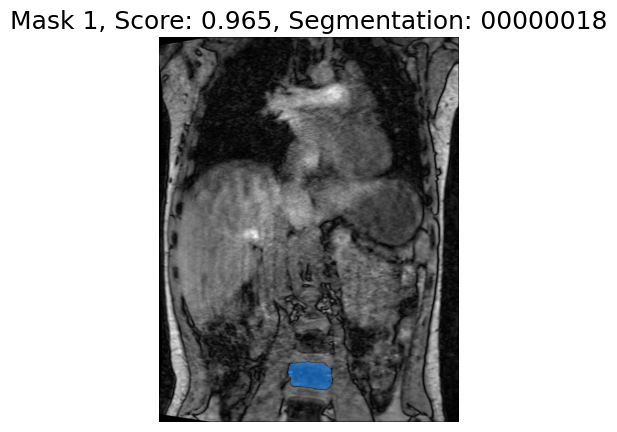

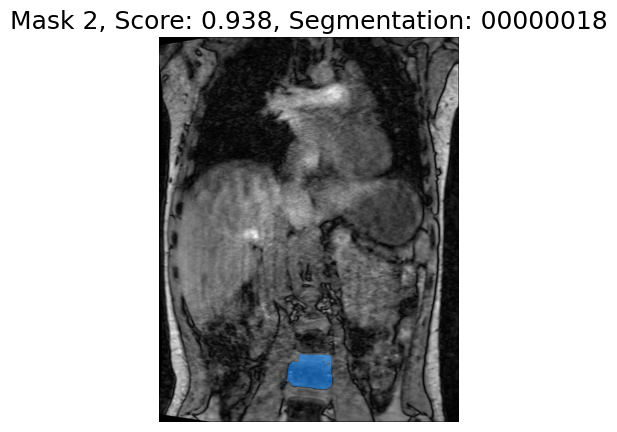

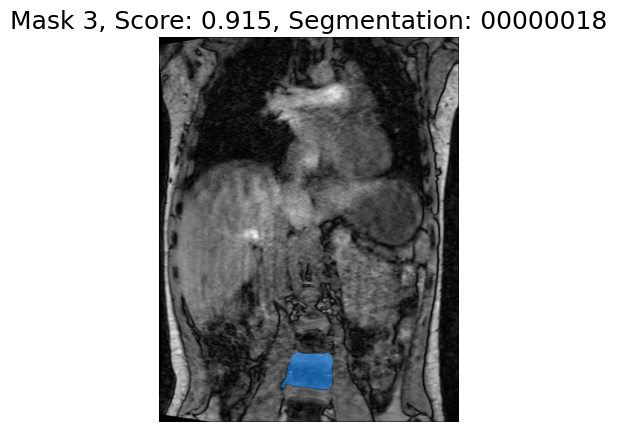

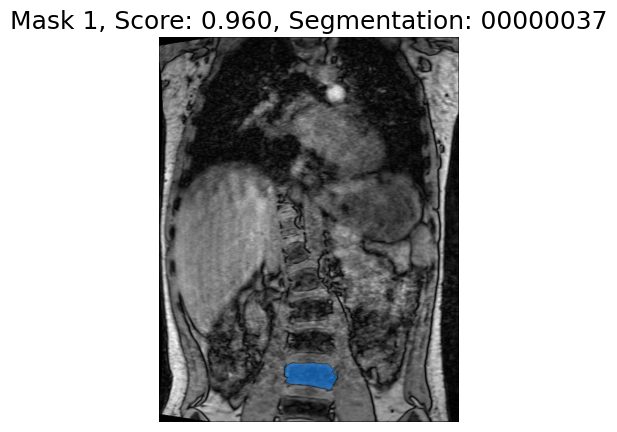

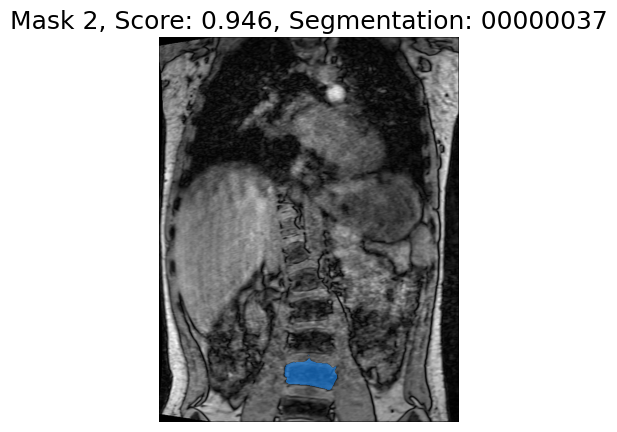

...

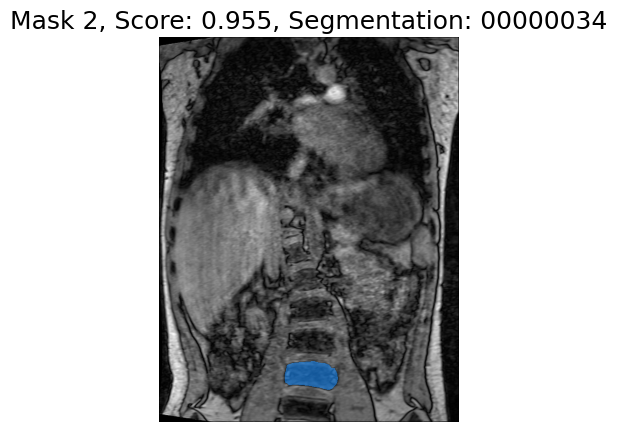

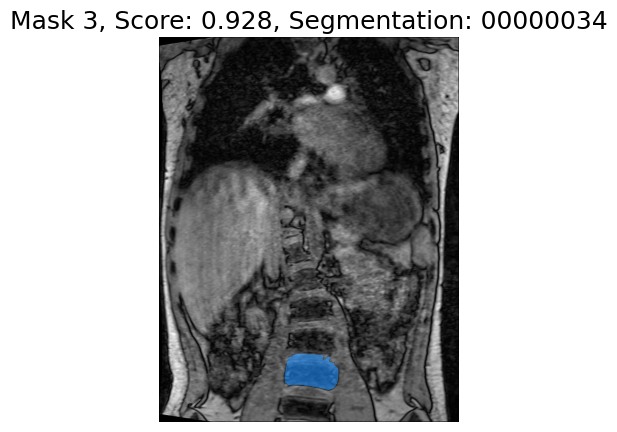

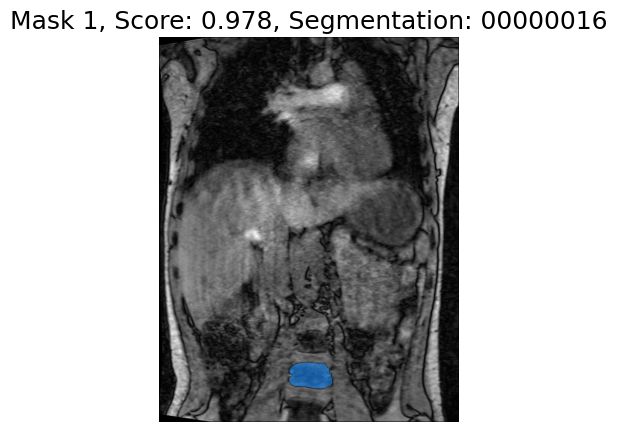

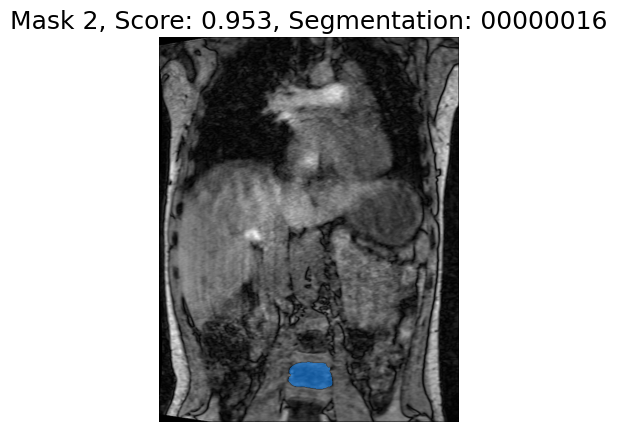

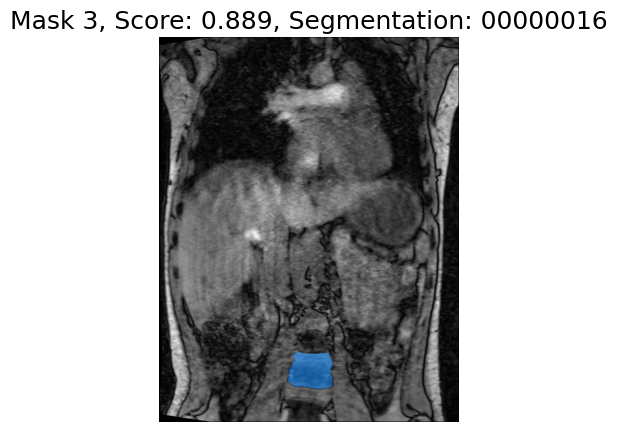

In [21]:
#https://towardsdatascience.com/meta-ai-introduces-revolutionary-image-segmentation-model-trained-on-1-billion-masks-8f13c86a13a2
import matplotlib.pyplot as plt
from skimage.io import imread,imsave
from skimage.color import rgb2gray


def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

# def show_points(coords, labels, ax, marker_size=375):
#     pos_points = coords[labels==1]
#     neg_points = coords[labels==0]
#     ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
#     ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

# #image =  imread(IMAGE_PATH)
#image =  image_rgb.copy()

for result in segmentation_results:

  OriginalIM = result.im

  for i, (mask, score) in enumerate(zip(result.masks, result.scores)):
      plt.figure(figsize=(5, 5))
      #plt.imshow(image_rgb)
      plt.imshow(OriginalIM, cmap = 'gray')
      show_mask(mask, plt.gca())
      #show_points(input_point, input_label, plt.gca())
      plt.title(f"Mask {i+1}, Score: {score:.3f}, Segmentation: {result.file_name}", fontsize=18)

      plt.axis('off')
      plt.show()

In [ ]:
import nibabel as nib
import numpy as np


# Assuming all masks have the same shape, get the shape of the first mask
mask_shape = segmentation_results[0].masks[0].shape

# Create an empty array to store all masks
all_masks = np.zeros((mask_shape[1], mask_shape[0]))

# Fill the array with masks
for i, result in enumerate(segmentation_results):
    # Assuming each result has only one mask, use the first mask
    rotated_mask = np.rot90(result.masks[0], k=1)
    flipped_mask = np.flip(rotated_mask, axis=0)
    all_masks[:, :] = flipped_mask
    # Create a NIfTI image from the array of masks
    nifti_img = nib.Nifti1Image(all_masks, affine=np.eye(4))


    file_name_save = '/content/drive/My Drive/SegmentAI/' + f'{result.file_name}.nii.gz'
    # Save the NIfTI image to a file
    nib.save(nifti_img, file_name_save)

# Example usage
#save_segmentation_results_as_nifti(segmentation_results, '/content/drive/My Drive/SegmentAI')

